Задание:

С помощью метода get_prepared_all_vacancies_from_hh
загрузить 10000 вакансии с сайта hh.ru.

Договоритесь чтобы вакансии не повторялись.

Сохранить результат в виде csv файла с тремя столбцами:
1. id вакансии
2. сырой json
3. подготовленное описание вакансии

Не забывайте про обработку ошибок

In [1]:
from urllib.request import urlopen
import json

def download_json(url):
  try:
    response = urlopen(url)
    data_json = json.loads(response.read())
  except Exception as e:
    data_json = {}
  return data_json
  
#пример: download_json('https://api.hh.ru/vacancies/43551857')

In [2]:
'''
РЕАЛИЗОВАТЬ remove_garbage
Используйте regex
IN: str '<p>ТРЕБОВАНИЯ: <br />- обязательно высшее или незаконченное высшее экономическое образование;...'
OUT: str 'ТРЕБОВАНИЯ: - обязательно высшее или незаконченное высшее экономическое образование;...'
'''
import re
def remove_garbage(raw_text):
  text = re.sub('<.*?>', '', raw_text)
  text = re.sub('&quot', '"', text)
  return text

remove_garbage('<p>ТРЕБОВАНИЯ: <br />- обязательно высшее или незаконченное высшее экономическое образование;... &quot')

'ТРЕБОВАНИЯ: - обязательно высшее или незаконченное высшее экономическое образование;... "'

In [3]:
!pip install nltk

You should consider upgrading via the 'c:\users\evgen\appdata\local\programs\python\python39\python.exe -m pip install --upgrade pip' command.


In [4]:
'''
РЕАЛИЗОВАТЬ tokenize
Используйте word_tokenize из nltk.tokenize
IN: str 'ТРЕБОВАНИЯ: - обязательно высшее или незаконченное высшее экономическое образование;...'
OUT: list ['требования', ':', '-', 'обязательно', 'высшее', 'или', 'незаконченное', 'высшее', 'экономическое', 'образование']
'''
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize
def tokenize(raw_text):
  tokens = word_tokenize(raw_text)
  return tokens

tokenize('ТРЕБОВАНИЯ: - "обязательно" высшее или незаконченное высшее экономическое образование;...')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\evgen\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


['ТРЕБОВАНИЯ',
 ':',
 '-',
 '``',
 'обязательно',
 "''",
 'высшее',
 'или',
 'незаконченное',
 'высшее',
 'экономическое',
 'образование',
 ';',
 '...']

In [6]:
!pip install pymystem3

You should consider upgrading via the 'c:\users\evgen\appdata\local\programs\python\python39\python.exe -m pip install --upgrade pip' command.


In [5]:
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\evgen\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [6]:
'''
РЕАЛИЗОВАТЬ to_base_form
Можно использовать и лемматизацию и стемминг: pymystem3, ntlk, Spacy, gensim
IN: str 'Красивая мама красиво мыла раму'
OUT: str 'красивый мама красиво мыть рама'
'''
from pymystem3 import Mystem
def to_base_form(raw_text):
  mstem = Mystem()
  tokens = mstem.lemmatize(raw_text)
  string = ''
  for elem in tokens[:-1]:
    string = string + elem
  return string

to_base_form('Красивая мама красиво мыла раму')

'красивый мама красиво мыть рама'

In [7]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\evgen\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [8]:
'''
РЕАЛИЗОВАТЬ remove_stop_words
Используйте stopwords из nltk.corpus 
IN: list ['требования', ':', '-', 'обязательно', 'высший', 'или', 'незаконченный', 'высший', 'экономический', 'образование']
OUT: list ['требование', 'обязательно', 'высший', 'незаконченный', 'высший', 'экономический', 'образование']
'''
import string
from nltk.corpus import stopwords
stop_words = set(stopwords.words('russian'))
punct = string.punctuation
def remove_stop_words(raw_text):
  text = [word for word in raw_text if not word in stop_words]
  text = [word for word in raw_text if not word in punct]
  return text

remove_stop_words(['требования', ':', '-', 'обязательно', 'высший', 'или', 'незаконченный', 'высший', 'экономический', 'образование'])

['требования',
 'обязательно',
 'высший',
 'или',
 'незаконченный',
 'высший',
 'экономический',
 'образование']

In [9]:
'''
РЕАЛИЗОВАТЬ get_prepared_vacancy_description_from_hh
Используйте реализованные ранее методы
IN: int 72323
OUT1: str vacancy_json dump
OUT2: list[list] [['требование', 'обязательно', 'высший', 'незаконченный', 'высший', 'экономический', 'образование', ...], [...], ...]
'''
def get_prepared_vacancy_from_hh(vacancy_id):
  base_url = 'https://api.hh.ru/vacancies/'
  vacancy_json = download_json(base_url + str(vacancy_id))
  if vacancy_json != {}:
    vacancy_description = vacancy_json['description']
    vacancy_description_sentences = re.split(r'(?<=\w[.!?]) ', vacancy_description)
    prepared_vacancy_description = []
    for sentence in vacancy_description_sentences:
      sentence_without = remove_garbage(sentence)
      base_sentence = to_base_form(sentence_without)
      tokenize_sentences = tokenize(base_sentence)
      correct_text = remove_stop_words(tokenize_sentences)
      prepared_vacancy_description.append(correct_text)
    return vacancy_json, prepared_vacancy_description

get_prepared_vacancy_from_hh(43551857)

({'id': '43551857',
  'premium': False,
  'billing_type': {'id': 'standard', 'name': 'Стандарт'},
  'relations': [],
  'name': 'Рабочий в производственные цеха',
  'insider_interview': None,
  'response_letter_required': False,
  'area': {'id': '68', 'name': 'Омск', 'url': 'https://api.hh.ru/areas/68'},
  'salary': {'from': 24000, 'to': 41000, 'currency': 'RUR', 'gross': False},
  'type': {'id': 'open', 'name': 'Открытая'},
  'address': {'city': 'Омск',
   'street': 'улица Будеркина',
   'building': '2',
   'description': None,
   'lat': 54.9591513865,
   'lng': 73.437212985,
   'raw': 'Омск, улица Будеркина, 2',
   'metro': None,
   'metro_stations': []},
  'allow_messages': True,
  'site': {'id': 'hh', 'name': 'hh.ru'},
  'experience': {'id': 'noExperience', 'name': 'Нет опыта'},
  'schedule': {'id': 'shift', 'name': 'Сменный график'},
  'employment': {'id': 'full', 'name': 'Полная занятость'},
  'department': None,
  'contacts': None,
  'description': '<p><strong>Обязанности:</stron

In [10]:
'''
РЕАЛИЗОВАТЬ get_prepared_all_vacancies_from_hh
Используйте get_prepared_vacancy_from_hh и ThreadPoolExecutor из concurrent.futures
IN: list [int]
OUT: list [vacancy_id, raw_description, prepared_description]
'''
import concurrent.futures
def get_prepared_all_vacancies_from_hh(vacancy_ids):
    result = []
    with concurrent.futures.ThreadPoolExecutor() as executor:
        futures = []
        for id in vacancy_ids:
            futures.append(executor.submit(get_prepared_vacancy_from_hh, vacancy_id = id))
        for future in concurrent.futures.as_completed(futures):
            result.append(future.result())
    return result

In [11]:
ids = range(47000000, 47010000, 1)
result = get_prepared_all_vacancies_from_hh(ids)

In [12]:
len(result)

10000

In [18]:
toCsv = []
for i in range(len(result)):
    temp = []
    if(result[i] != None):
        temp.append(result[i][0]['id'])
        temp.append(result[i][0])
        temp.append(result[i][1])
        toCsv.append(temp)

In [15]:
result[0][0]['id']

'47000000'

[['47000000',
  {'id': '47000000',
   'premium': False,
   'billing_type': {'id': 'standard', 'name': 'Стандарт'},
   'relations': [],
   'name': 'Менеджер по подбору персонала (удалённо)',
   'insider_interview': None,
   'response_letter_required': False,
   'area': {'id': '112',
    'name': 'Ярославль',
    'url': 'https://api.hh.ru/areas/112'},
   'salary': None,
   'type': {'id': 'open', 'name': 'Открытая'},
   'address': None,
   'allow_messages': True,
   'site': {'id': 'hh', 'name': 'hh.ru'},
   'experience': {'id': 'noExperience', 'name': 'Нет опыта'},
   'schedule': {'id': 'fullDay', 'name': 'Полный день'},
   'employment': {'id': 'full', 'name': 'Полная занятость'},
   'department': None,
   'contacts': None,
   'description': '<p><strong>Вам предстоит:</strong></p> <ul> <li>Поиск линейного персонала (водители, курьеры и т.д) на работных площадках;</li> <li>Проведение телефонного интервью с кандидатами;</li> <li>Качественное выполнение стандартов компании;</li> <li>Обработка
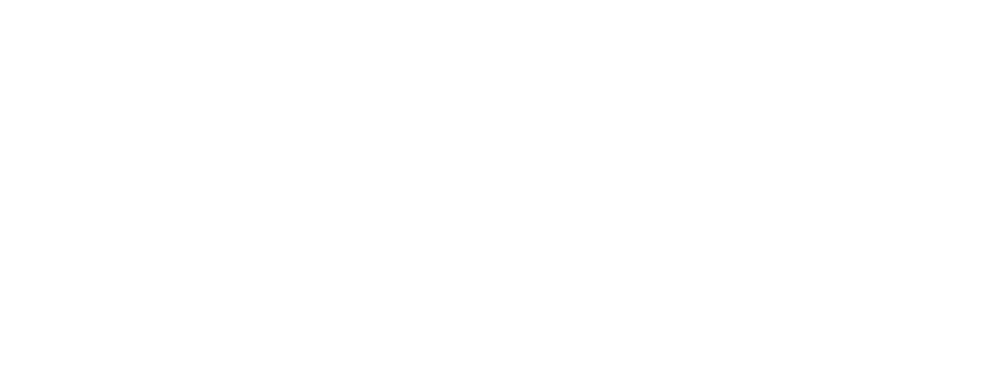

In [19]:
toCsv

In [23]:
import pandas as pd

In [26]:
data = pd.DataFrame(toCsv)
data

,0,1,2
0,47000000,"{'id': '47000000', 'premium': False, 'billing_...","[[вы, предстоять, поиск, линейный, персонал, в..."
1,47000013,"{'id': '47000013', 'premium': False, 'billing_...","[[обязанность, армирование, бетонирование, изг..."
2,47000007,"{'id': '47000007', 'premium': False, 'billing_...","[[обязанность, разработка, новый, функционал, ..."
3,47000014,"{'id': '47000014', 'premium': False, 'billing_...","[[обязанность, армирование, бетонирование, изг..."
4,47000011,"{'id': '47000011', 'premium': False, 'billing_...","[[обязанность, армирование, бетонирование, изг..."
...,...,...,...
3761,47003979,"{'id': '47003979', 'premium': False, 'billing_...","[[логистический, компания, требоваться, менедж..."
3762,47003982,"{'id': '47003982', 'premium': False, 'billing_...","[[modi, fun, shop, –, это, розничный, магазин,..."
3763,47003994,"{'id': '47003994', 'premium': False, 'billing_...","[[здравствовать, давать, познакомиться, я, зва..."
3764,47003993,"{'id': '47003993', 'premium': False, 'billing_...","[[мы, искать, копирайтер, для, канал, яндекс],..."


In [32]:
data.to_csv('data/vavacancies.csv', index=False)

[({'id': '47000000',
   'premium': False,
   'billing_type': {'id': 'standard', 'name': 'Стандарт'},
   'relations': [],
   'name': 'Менеджер по подбору персонала (удалённо)',
   'insider_interview': None,
   'response_letter_required': False,
   'area': {'id': '112',
    'name': 'Ярославль',
    'url': 'https://api.hh.ru/areas/112'},
   'salary': None,
   'type': {'id': 'open', 'name': 'Открытая'},
   'address': None,
   'allow_messages': True,
   'site': {'id': 'hh', 'name': 'hh.ru'},
   'experience': {'id': 'noExperience', 'name': 'Нет опыта'},
   'schedule': {'id': 'fullDay', 'name': 'Полный день'},
   'employment': {'id': 'full', 'name': 'Полная занятость'},
   'department': None,
   'contacts': None,
   'description': '<p><strong>Вам предстоит:</strong></p> <ul> <li>Поиск линейного персонала (водители, курьеры и т.д) на работных площадках;</li> <li>Проведение телефонного интервью с кандидатами;</li> <li>Качественное выполнение стандартов компании;</li> <li>Обработка поступающих з
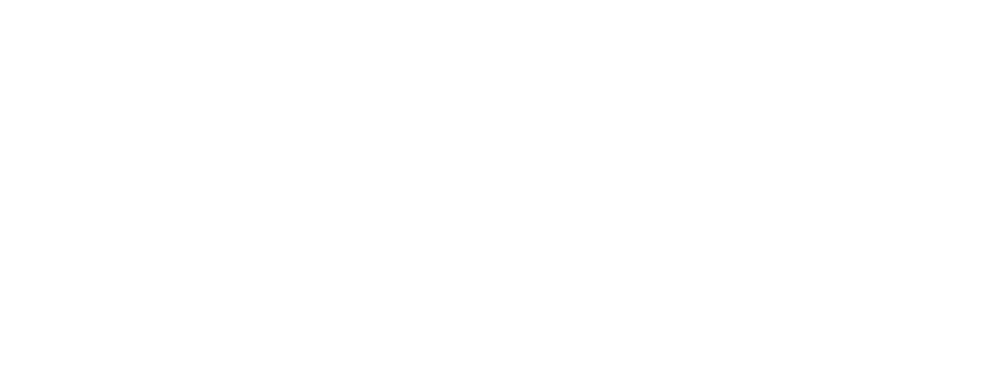

In [14]:
result